<a href="https://colab.research.google.com/github/jemma-mg/audio-processing-python/blob/main/audio_processing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Familization of python tools for speech processing


### 1. display and play

In [ ]:
from IPython.display import display,Audio

display(Audio("./Jab_tak.wav"))

In [ ]:
from IPython.display import display,Audio

display(Audio("./mudhal_nee_mudivum_nee.wav"))

### 2. Read or write audiofiles

In [ ]:
import soundfile as sf

data, sr = sf.read("./Jab_tak.wav")
print(data.shape,sr)

sf.write("new_file.flac",data,sr)

(5585176,) 48000


### 3. Read or write wavefiles

In [ ]:
import wave

In [ ]:
obj=wave.open("./kando_kando.wav","r")

#open wave file
print("channels: ",obj.getnchannels())
print("sample width: ",obj.getsampwidth())
print("frame rate: ",obj.getframerate())
print("number of frames: ",obj.getnframes())
print("parameters: ",obj.getparams())
frames=obj.readframes(obj.getnframes())
obj.close()


channels:  1
sample width:  2
frame rate:  48000
number of frames:  5919256
parameters:  _wave_params(nchannels=1, sampwidth=2, framerate=48000, nframes=5919256, comptype='NONE', compname='not compressed')


In [ ]:
# write to file
sr=16000
obj=wave.open("./edited/kando_kando.wav","w")
obj.setnchannels(1)
obj.setsampwidth(2)
obj.setframerate(sr)
obj.writeframes(frames)
obj.close()

### 4. PyAudio - record mic and I/O lib
### 5. sounddevice - record mic and playaudio

### 6. Librosa - music and audio analysis

In [ ]:
import librosa

In [ ]:
data,sr = librosa.load("./Jab_tak.wav",sr=48000)
print(data.shape,sr)

(5585176,) 48000


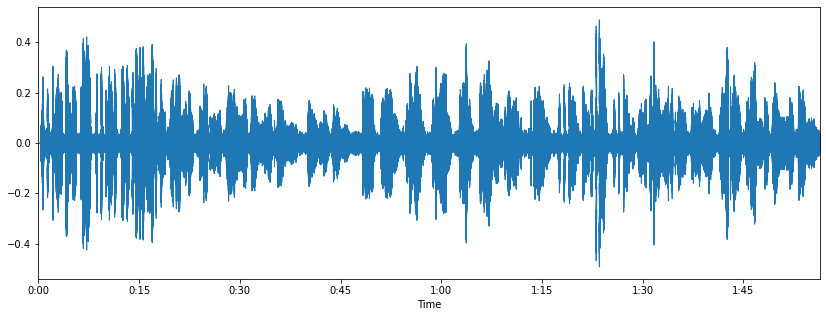

In [ ]:
import matplotlib.pyplot as plt
import librosa.display

plt.figure(figsize=(14,5))
librosa.display.waveplot(data,sr=sr)
plt.show()

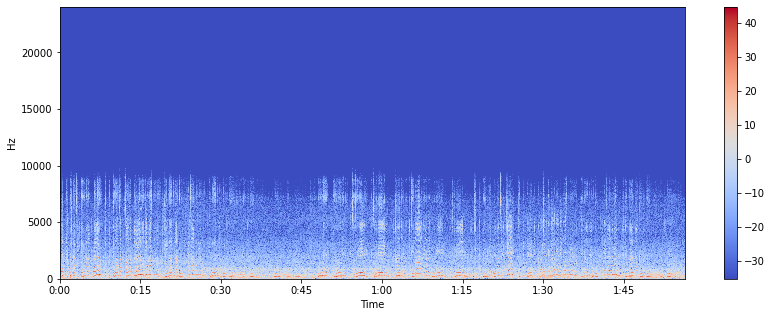

In [ ]:
#spectrogram
X = librosa.stft(data)
Xdb = librosa.amplitude_to_db(abs(X))

plt.figure(figsize=(14,5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time',y_axis='hz')
plt.colorbar()
plt.show()

### 7. manipulate audio mp3 and others

In [ ]:
!pip install pydub

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import pydub

In [ ]:
from pydub import AudioSegment
from pydub.playback import play
 
tape = AudioSegment.from_file('./malare.wav', format='wav')

In [ ]:
play(tape)

In [ ]:
from pydub import AudioSegment

audio1 = AudioSegment.from_wav('./Jab_tak.wav')
audio2 = AudioSegment.from_wav('./kando_kando.wav')
# audio = audio1 * audio2 #audio mixing
# audio = audio1 + audio2 #audio appending
audio = audio1 * audio2
# audio = audio + 5 #boost volume by 5db
# audio = audio * 2 #repeat audio twice
audio = audio.fade_in(2000) #2 sec fade in
# audio = audio.speedup(playback_speed=1.5) #playback_Speed x 1.5
audio.export('edited/Jab_tak.wav', format='wav')

<_io.BufferedRandom name='edited/Jab_tak.wav'>

In [ ]:
display(Audio("./edited/Jab_tak.wav"))

### 8. Pytorch audio

In [ ]:
import torch
import torchaudio

waveform, sample_rate = torchaudio.load("./malare.wav")

waveform.shape, sample_rate

(torch.Size([1, 6403096]), 48000)

In [ ]:
#Resampling

import torchaudio.transforms as T
import torchaudio.functional as F

waveform, sample_rate = torchaudio.load("./malare.wav")

resample_rate = 96000

resampledwaveform1 = F.resample(waveform, sample_rate, resample_rate, lowpass_filter_width=12)
resampledwaveform2 = F.resample(waveform, sample_rate, resample_rate, resampling_method="kaiser_window")